<a href="https://colab.research.google.com/github/Juliarty/kdd-project/blob/main/Diabetes_XAI.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 0. Подготовка к работе

In [2]:
##@title Installation of DoWhy and other packAges {display-mode: "form"}
!pip install dowhy
!apt install libgraphviz-dev
!pip install pygraphviz

     |████████████████████████████████| 123 kB 4.2 MB/s 
  Attempting uninstall: pydot
    Found existing installation: pydot 1.3.0
    Uninstalling pydot-1.3.0:
      Successfully uninstalled pydot-1.3.0
Reading package lists... Done
Building dependency tree       
Reading state information... Done
The following additional packages will be installed:
  libgail-common libgail18 libgtk2.0-0 libgtk2.0-bin libgtk2.0-common
  libgvc6-plugins-gtk libxdot4
Suggested packages:
  gvfs
The following NEW packages will be installed:
  libgail-common libgail18 libgraphviz-dev libgtk2.0-0 libgtk2.0-bin
  libgtk2.0-common libgvc6-plugins-gtk libxdot4
0 upgraded, 8 newly installed, 0 to remove and 37 not upgraded.
Need to get 2,120 kB of archives.
After this operation, 7,128 kB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/ubuntu bionic/main amd64 libgtk2.0-common all 2.24.32-1ubuntu1 [125 kB]
Get:2 http://archive.ubuntu.com/ubuntu bionic/main amd64 libgtk2.0-0 amd64 2.24.32-

In [3]:
##@title Helper functions {display-mode: "form"}

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import os, sys

# Config dict to set the logging level
import logging.config
DEFAULT_LOGGING = {
    'version': 1,
    'disable_existing_loggers': False,
    'loggers': {
        '': {
            'level': 'INFO',
        },
    }
}

logging.config.dictConfig(DEFAULT_LOGGING)
# Disabling warnings output
import warnings
from sklearn.exceptions import DataConversionWarning, ConvergenceWarning
warnings.filterwarnings(action='ignore', category=DataConversionWarning)
warnings.filterwarnings(action='ignore', category=ConvergenceWarning)
warnings.filterwarnings(action='ignore', category=UserWarning)

#!pip install dowhy
import dowhy
from dowhy import CausalModel
import dowhy.datasets

from IPython.display import Image, display

from sklearn.impute import SimpleImputer


In [4]:
!gdown --id 1wwpquQgYQizBLHs761Rhz0qmLvHrU50t
!unzip -q -n diabetes.zip

Downloading...
From: https://drive.google.com/uc?id=1wwpquQgYQizBLHs761Rhz0qmLvHrU50t
To: /content/diabetes.zip
100% 9.05k/9.05k [00:00<00:00, 3.56MB/s]


In [5]:
# importing dataset
df = pd.read_csv('diabetes.csv')
df = df.astype({'Outcome': 'category'})

# one of the main problems of that dataset that it contains missing values
# that set to zero
df.loc[df["Glucose"] == 0.0, "Glucose"] = pd.NA
df.loc[df["BloodPressure"] == 0.0, "BloodPressure"] = pd.NA
df.loc[df["SkinThickness"] == 0.0, "SkinThickness"] = pd.NA
df.loc[df["Insulin"] == 0.0, "Insulin"] = pd.NA
df.loc[df["BMI"] == 0.0, "BMI"] = pd.NA

df = df.fillna(df.mean())
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 768 entries, 0 to 767
Data columns (total 9 columns):
 #   Column                    Non-Null Count  Dtype   
---  ------                    --------------  -----   
 0   Pregnancies               768 non-null    int64   
 1   Glucose                   768 non-null    float64 
 2   BloodPressure             768 non-null    float64 
 3   SkinThickness             768 non-null    float64 
 4   Insulin                   768 non-null    float64 
 5   BMI                       768 non-null    float64 
 6   DiabetesPedigreeFunction  768 non-null    float64 
 7   Age                       768 non-null    int64   
 8   Outcome                   768 non-null    category
dtypes: category(1), float64(6), int64(2)
memory usage: 49.0 KB


## 0.1. Описание данных.

Pregnancies - Number of times pregnant

Glucose - Plasma glucose concentration a 2 hours in an oral glucose tolerance test

BloodPressure - Diastolic blood pressure (mm Hg)

SkinThickness - Triceps skin fold thickness (mm)

Insulin - 2-Hour serum insulin (mu U/ml)

BMI - Body mass index (weight in kg/(height in m)^2)

DiabetesPedigreeFunction - Diabetes pedigree function

Age - Age (years)

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f44bb765250>,
      dtype=object)

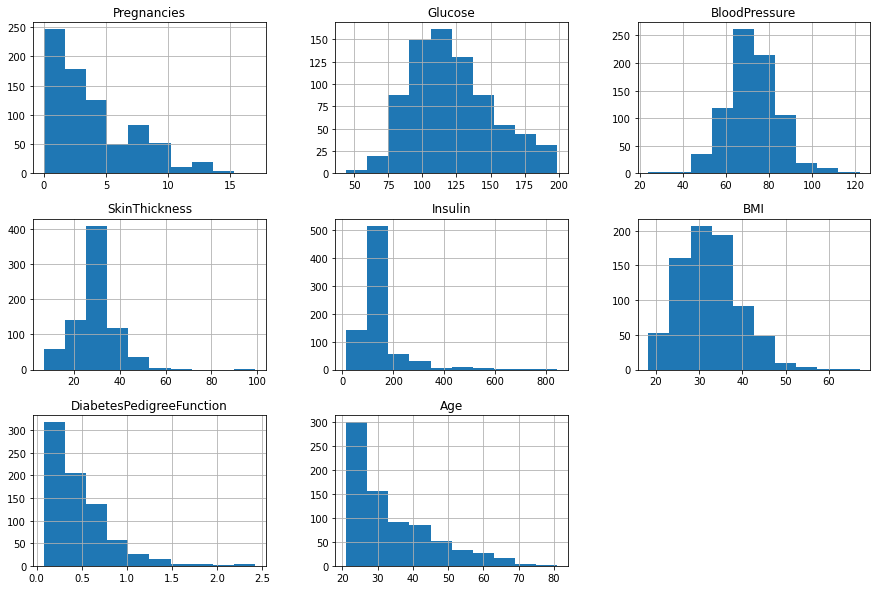

In [6]:
fig = plt.figure(figsize = (15,10))
ax = fig.gca()
df.hist(ax = ax)

# 1. Поиск причинно-следственных связей.

##1.1 Модель на основе предположений.




### 1.1.1 Установление скоррелированных признаков

In [7]:
corr = df.corr()
corr.style.background_gradient(cmap='coolwarm').set_precision(2)

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age
Pregnancies,1.00,0.13,0.21,0.08,0.06,0.02,-0.03,0.54
Glucose,0.13,1.00,0.22,0.19,0.42,0.23,0.14,0.27
BloodPressure,0.21,0.22,1.00,0.19,0.07,0.28,-0.00,0.32
SkinThickness,0.08,0.19,0.19,1.00,0.16,0.54,0.10,0.13
Insulin,0.06,0.42,0.07,0.16,1.00,0.17,0.10,0.14
BMI,0.02,0.23,0.28,0.54,0.17,1.00,0.15,0.03
DiabetesPedigreeFunction,-0.03,0.14,-0.00,0.10,0.10,0.15,1.00,0.03
Age,0.54,0.27,0.32,0.13,0.14,0.03,0.03,1.00


Наибольшая корреляция между парами:

1. (Pregnancies, Age).
2. (Glucose, Insulin).
3. (Glucose, Age).
4. (BloodPressure, BMI).
5. (BloodPressure, Age).
6. (SkinThikness, Insulin).
7. (SkinThikness, BMI).
8. (Outcome, Glucose).
9. (Outcome, BMI).
10. (Outcome, Age). 



### 1.1.2 Предположения о причинно-следственных связях. Граф связей.

Сделаем следующие предположения:
1.   Возраст влияет на давление.
2.   Число беременностей влияет на возраст.
2.   Индекс массы тела влияет на толщину кожу и давление.
3.   Индекс массы тела, наследственность, возраст, число беременностей влияют на наличие диабета.
4. Наличие диабета влияет на инсулин и уровень глюкозы.



In [8]:
features = [feature for feature in df.columns if feature != 'Outcome']
features

['Pregnancies',
 'Glucose',
 'BloodPressure',
 'SkinThickness',
 'Insulin',
 'BMI',
 'DiabetesPedigreeFunction',
 'Age']

In [9]:
causal_graph = """digraph {
Pregnancies[label="Pregnancies"];
Glucose[label="Glucose"];
BloodPressure[label="BloodPressure"];
SkinThickness[label="SkinThickness"];
Insulin[label="Insulin"];
BMI[label="BMI"];
DiabetesPedigreeFunction[label="DiabetesPedigreeFunction"];
Age[label="Age"];
Outcome[label="Outcome"];
Age->BloodPressure;Age->Outcome;
Pregnancies -> Age;
BMI->SkinThickness; BMI->BloodPressure; BMI->Outcome;
DiabetesPedigreeFunction->Outcome;
Outcome -> Glucose; Outcome -> Insulin;
Pregnancies->Outcome;
}
"""

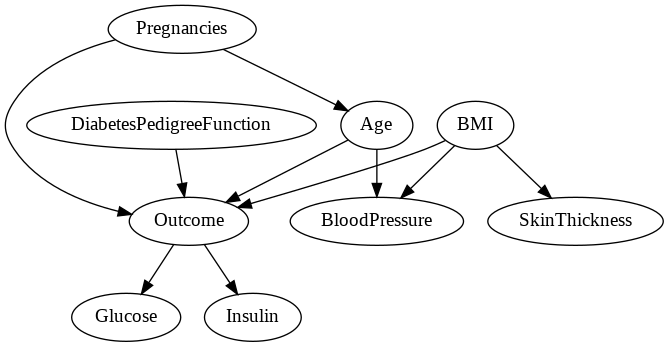

In [10]:
def get_causal_model(causal_graph, treatment, outcome):
  model= dowhy.CausalModel(
        data = df,
        graph=causal_graph.replace("\n", " "),
        treatment=treatment,
        #instruments=['Culture', 'U'],
        #confounders=['U'],
        outcome=outcome)
  model.view_model()
  return model

model = get_causal_model(causal_graph, [], [])
display(Image(filename="causal_model.png"))


Для проверки гипотез о причинно-следственных связях воспользуемся следующими методами:

1.   placebo_treatment_refuter (например, наличие диабета может и не оказывать влияние на уровень глюкозы);
2.   add_unobserved_common_cause (например, на толщину кожи может влиять признаки отсутствующие в датасете);
3.   data_subset_refuter (эффекты одних признаков на другие могут отличаться для некоторых подмножеств в датасете, что может свидетельствовать о несостоятельности выбора гипотез и существовании других зависимостей между признаками).



In [11]:
def refute(identified_estimand, estimate):
  res_unobserved=model.refute_estimate(identified_estimand, estimate, method_name="add_unobserved_common_cause",
                                     confounders_effect_on_treatment="linear", confounders_effect_on_outcome="linear",
                                    effect_strength_on_treatment=0.01, effect_strength_on_outcome=0.02)
  print(res_unobserved)
  res_subset=model.refute_estimate(identified_estimand, estimate,
          method_name="data_subset_refuter", subset_fraction=0.6)
  print(res_subset)
  res_placebo=model.refute_estimate(identified_estimand, estimate,
          method_name="placebo_treatment_refuter", placebo_type="permute")
  print(res_placebo)

#### 1.1.2.1 Возраст и число беременностей.
Проверим влияние числа беременностей на возраст. 

Так как число беременностей может и не оказывать такой сильный эффект на возраст, воспользуемся методом 'placebo_treatment_refuter'.


In [12]:

model = get_causal_model(causal_graph, 'Pregnancies','Age')
identified_estimand = model.identify_effect(proceed_when_unidentifiable=True)
estimate = model.estimate_effect(identified_estimand, method_name="backdoor.linear_regression",target_units="ate")
refute(identified_estimand, estimate)


/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


Refute: Add an Unobserved Common Cause
Estimated effect:1.8786681365350333
New effect:1.8789411196014498

Refute: Use a subset of data
Estimated effect:1.8786681365350333
New effect:1.8858028797294104
p value:0.47

Refute: Use a Placebo Treatment
Estimated effect:1.8786681365350333
New effect:-0.005259621901666733
p value:0.44999999999999996



Результаты применения refutation методов свидетельствуют о наличии положительного эффекта.

#### 1.1.2.2 Диабет и глюкоза.
Проверим влияние наличия диабета на уровень глюкозы. 

In [13]:
model = get_causal_model(causal_graph, 'Outcome','Glucose')
identified_estimand = model.identify_effect(proceed_when_unidentifiable=True)
estimate = model.estimate_effect(identified_estimand, method_name="backdoor.linear_regression",target_units="ate")

refute(identified_estimand, estimate)


Refute: Add an Unobserved Common Cause
Estimated effect:29.12797942927905
New effect:29.1454969453646

Refute: Use a subset of data
Estimated effect:29.12797942927905
New effect:29.156850422166354
p value:0.43

Refute: Use a Placebo Treatment
Estimated effect:29.12797942927905
New effect:-0.06897073889907163
p value:0.44999999999999996



Результаты применения refutation методов свидетельствуют о наличии положительного эффекта.

#### 1.1.2.3 Индекс массы тела и толщина кожи.
Проверим влияние индекса массы тела на толщину кожи.


In [14]:
model = get_causal_model(causal_graph,'BMI','SkinThickness' )
identified_estimand = model.identify_effect(proceed_when_unidentifiable=True)
estimate = model.estimate_effect(identified_estimand, method_name="backdoor.linear_regression",target_units="ate")
refute(identified_estimand, estimate)

Refute: Add an Unobserved Common Cause
Estimated effect:0.6866470708420866
New effect:0.6867726439379158

Refute: Use a subset of data
Estimated effect:0.6866470708420866
New effect:0.6844718339868698
p value:0.47

Refute: Use a Placebo Treatment
Estimated effect:0.6866470708420866
New effect:0.002524738618204907
p value:0.44



Результаты применения refutation методов свидетельствуют о наличии положительного эффекта.

## 1.2 Модель на основе графа взаимосвязей по умолчанию.


In [15]:
features = [feature for feature in df.columns if feature != 'Outcome']
features

['Pregnancies',
 'Glucose',
 'BloodPressure',
 'SkinThickness',
 'Insulin',
 'BMI',
 'DiabetesPedigreeFunction',
 'Age']

In [16]:


treatment = 'DiabetesPedigreeFunction'
outcome = 'Outcome'
def get_default_model(treatment, outcome):
  common_causes  = features.copy()
  if treatment in common_causes: 
    common_causes.remove(treatment)
  if outcome in common_causes: 
    common_causes.remove(outcome)

  model=CausalModel(
        data = df,
        treatment=treatment,
        outcome= outcome,
        common_causes=common_causes
        )
  return model


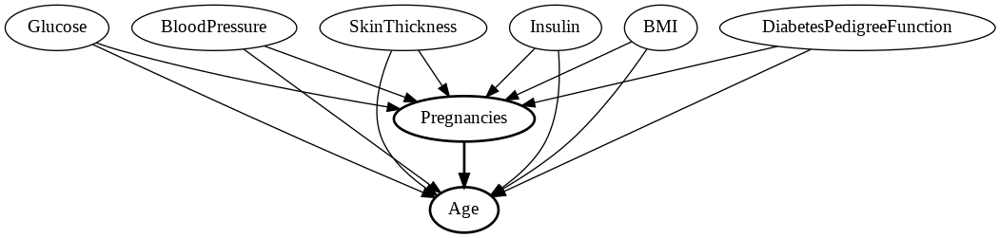

Refute: Add an Unobserved Common Cause
Estimated effect:1.6606057451612486
New effect:1.660590634285029

Refute: Use a subset of data
Estimated effect:1.6606057451612486
New effect:1.664531025312824
p value:0.45

Refute: Use a Placebo Treatment
Estimated effect:1.6606057451612486
New effect:0.0017357378358853737
p value:0.47



In [17]:
model = get_default_model('Pregnancies', 'Age')
model.view_model()
display(Image(filename="causal_model.png"))
identified_estimand = model.identify_effect(proceed_when_unidentifiable=True)
estimate = model.estimate_effect(identified_estimand, method_name="backdoor.linear_regression",target_units="ate")
refute(identified_estimand, estimate)

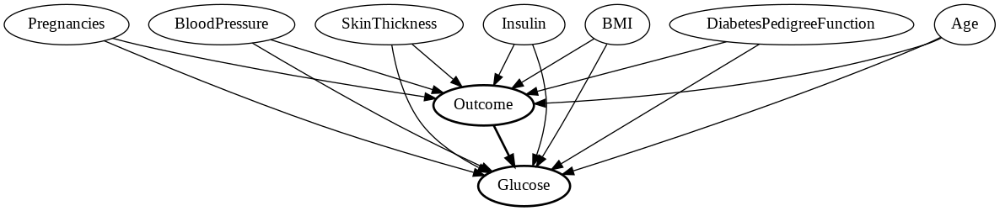

Refute: Add an Unobserved Common Cause
Estimated effect:24.179292723811955
New effect:24.21239043589442

Refute: Use a subset of data
Estimated effect:24.179292723811955
New effect:24.07804419167048
p value:0.47

Refute: Use a Placebo Treatment
Estimated effect:24.179292723811955
New effect:-0.19090026751618652
p value:0.45999999999999996



In [18]:
model = get_default_model('Outcome', 'Glucose')
model.view_model()
display(Image(filename="causal_model.png"))
identified_estimand = model.identify_effect(proceed_when_unidentifiable=True)
estimate = model.estimate_effect(identified_estimand, method_name="backdoor.linear_regression",target_units="ate")
refute(identified_estimand, estimate)


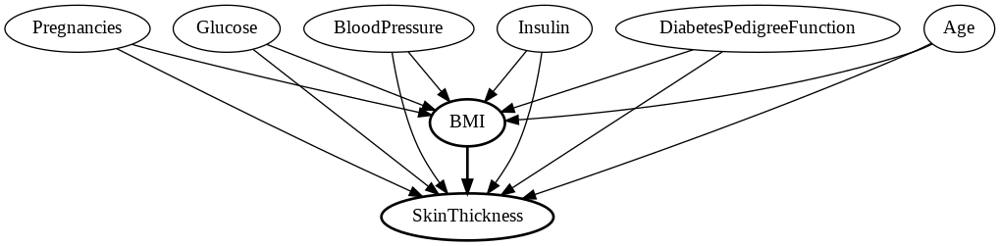

Refute: Add an Unobserved Common Cause
Estimated effect:0.6698096782024656
New effect:0.669906546650723

Refute: Use a subset of data
Estimated effect:0.6698096782024656
New effect:0.670558333848666
p value:0.48

Refute: Use a Placebo Treatment
Estimated effect:0.6698096782024656
New effect:-0.005741965953092887
p value:0.43000000000000005



In [19]:
model = get_default_model('BMI', 'SkinThickness' )
model.view_model()
display(Image(filename="causal_model.png"))
identified_estimand = model.identify_effect(proceed_when_unidentifiable=True)
estimate = model.estimate_effect(identified_estimand, method_name="backdoor.linear_regression",target_units="ate")
refute(identified_estimand, estimate)

## Выводы.



Эффекты оказываемые одними признаками на другие (Pregnancies -> Age, Outcome -> Glucose, BMI -> SkinThikness) являются положительными как для графа на основе предположений, так и для графа по умолчанию. При этом значения эффектов для разных графов приблизительно равны.

Результаты применения refutation методов не свидетельствуют об ошибочности сделанных предположений.


#2. Обучение моделей черного ящика.

## 2.1 Построение моделей.


In [20]:
#@title Installing SHAP {display-mode: "form"}

try:
  !pip install shap
  !pip install lime
  #!pip install -U scikit-learn
  #!pip install shapley-effects
  from google.colab import files
except:
  pass


class ShapObject:
    
    def __init__(self, base_values, data, values, feature_names):
        self.base_values = base_values # Single value
        self.data = data # Raw feature values for 1 row of data
        self.values = values # SHAP values for the same row of data
        self.feature_names = feature_names # Column names

     |████████████████████████████████| 371 kB 4.3 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
  Created wheel for shap: filename=shap-0.40.0-cp37-cp37m-linux_x86_64.whl size=509234 sha256=e2814296a05b7d852cffb74874fa7dd2d94ff9fe969a0f19625e8cd78f3bb0ab
  Stored in directory: /root/.cache/pip/wheels/ec/35/84/e304841ac4b910bc95fe9a6e5302eb2507b4333728851dcbfb
Successfully built shap
     |████████████████████████████████| 275 kB 4.0 MB/s 
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283857 sha256=536ae316bbdb0beaf5f20b7fc0aef93515ade580296afbc98285dc987db714b2
  Stored in directory: /root/.cache/pip/wheels/ca/cb/e5/ac701e12d365a08917bf4c6171c0961bc880a8181359c66aa7
Successfully built lime


In [21]:
#@title Package import {display-mode: "form"}

import sklearn

from sklearn.preprocessing import LabelEncoder
from sklearn.neural_network import MLPClassifier
from sklearn.linear_model import LogisticRegression

import xgboost

import shap
import lime
import lime.lime_tabular
from lime import submodular_pick

from sklearn.metrics import accuracy_score
import operator

import matplotlib.pyplot as plt

np.random.seed(1)

### 2.1.1 Обучение моделей.

In [22]:
np.random.seed(0)

linear_clf = LogisticRegression(penalty='l2', solver='liblinear')
xgb_clf = xgboost.XGBClassifier(max_depth=5, min_child_weight=0.6, sampling_method='gradient_based')
nn = MLPClassifier(solver='lbfgs', alpha=5e-4, hidden_layer_sizes=(32, 8, 4), 
                   random_state=1)

classifiers = [('Linear', linear_clf), ('XGBoost', xgb_clf), ('Neural Network', nn)]
train, test, labels_train, labels_test = sklearn.model_selection.train_test_split(df.drop(["Outcome"], axis=1), df["Outcome"], train_size=0.75)

print("Model accuracies")
for name, clf in classifiers:
  clf.fit(train, labels_train)
  print("{1:20s} {0:.2f}".format(accuracy_score(labels_test, clf.predict(test)),name))

Model accuracies
Linear               0.77
XGBoost              0.80
Neural Network       0.79


# 3. Применение SHAP.


## 3.1. Сравнение важностей признаков ансамбля деревьев решений с SHAP values.

Text(0.5, 1.0, 'XGBoost feature importance')

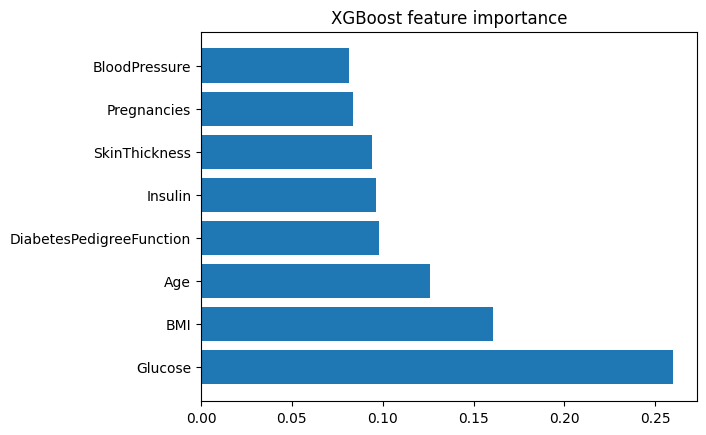

In [24]:
# feature importance for XGBoost classifier
fi = {n:v for n,v in zip(features,xgb_clf.feature_importances_.T)}
sorted_fi = sorted(fi.items(), key=operator.itemgetter(1))

plt.rcdefaults()
fig, ax = plt.subplots()

ax.barh(range(len(sorted_fi)), [v[1] for v in sorted_fi], align='center')
ax.set_yticks(range(len(sorted_fi)))
ax.set_yticklabels([v[0] for v in sorted_fi])
ax.invert_yaxis()  # labels read top-to-bottom
ax.set_title('XGBoost feature importance')


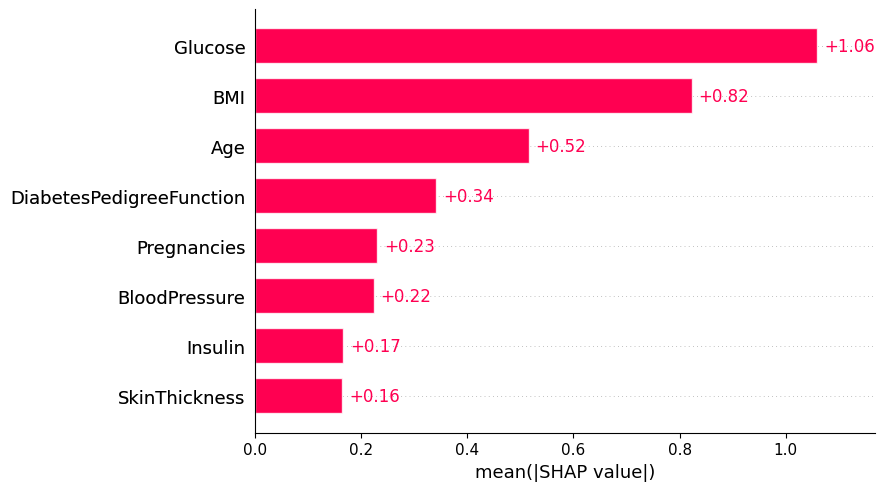

In [25]:
explainer = shap.Explainer(xgb_clf, train, feature_names=features)
shap_values = explainer(train)
shap.plots.bar(shap_values)

### Выводы.

Построенные графики важностей признаков (на основе SHAP и ансамбля деревьев) схожи, так как совпадают признаки с наибольшей важностью (а именно Glucose, BMI, Age, DiabetesPedigreeFunction). Признаки с наименьшей важностью отличаются порядком, но и относительные разности значений между ними по модулю совпадают для обоих графиков.

## 3.2. Анализ SHAP-values для всего набора данных в целом.

Так точность рассматриваемых моделей отличается незначительно, рассмотрим значения SHAP-values для ансамбля деревьев.  

### 3.2.1. Важности признаков в классе больных диабетом.

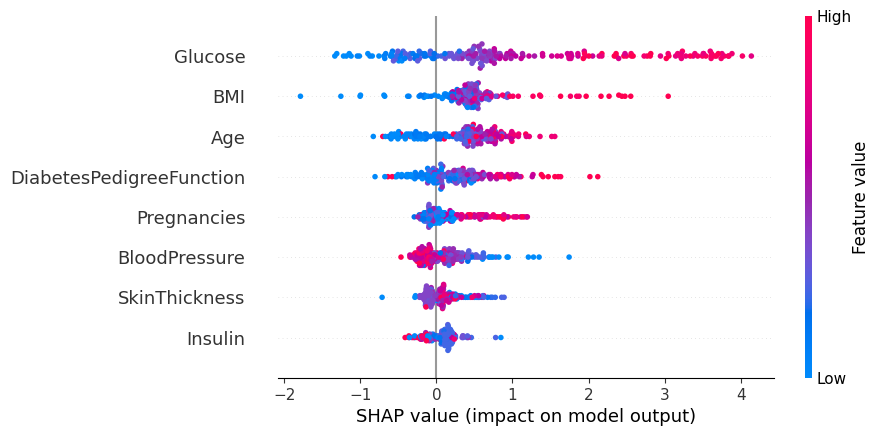

In [26]:
positive_train = train.loc[labels_train == 1]
explainer = shap.Explainer(xgb_clf, feature_names=features)
shap_values = explainer.shap_values(positive_train)
shap.summary_plot(shap_values, positive_train, features)

### 3.2.1. Важности признаков в классе не больных диабетом.

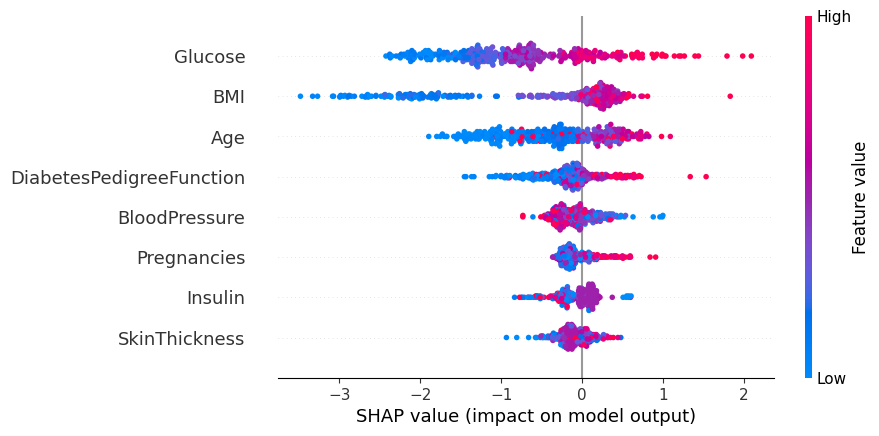

In [27]:
negative_train = train.loc[labels_train == 0]
explainer = shap.Explainer(xgb_clf, feature_names=features)
shap_values = explainer.shap_values(negative_train)
shap.summary_plot(shap_values, negative_train, features)

### Выводы.

Из графиков важности признаков для классов больных/не больных диабетом можно сделать вывод о том, что и в том, и вдругом классе признаки с наибольшой важностью и с наиментьшей важностью совпадают.

Основным отличием является то, что большие значения наиболее важных признаков имеют положительный эффект в классе больных диабетом, а меньшие значения этих же признаков имеют отрицательный вклад в классе не больных диабетом.

## 3.3. Использование SHAP для объяснения примеров.

### 3.3.1. Объяснение примеров XGBoost.

In [28]:
explainer = shap.TreeExplainer(xgb_clf)
labels_test_predicted = xgb_clf.predict(test)
shap_values = explainer.shap_values(test)
prediction_true = (labels_test == labels_test_predicted)

true_positive = (prediction_true == True) & (labels_test == 1)
true_negative =(prediction_true == True) & (labels_test == 0)
false_positive = (prediction_true == False) & (labels_test == 0)
false_negative = (prediction_true == False) & (labels_test == 1)

In [29]:
print("True positive example.")
true_1 = (test.loc[true_positive]).iloc[0]
shap_value = explainer.shap_values(true_1)[0]
shap.initjs()
shap.force_plot(explainer.expected_value, shap_value, true_1, feature_names=features)

True positive example.


In [30]:
print("True negative example.")
true_0 = (test.loc[true_negative]).iloc[0]
shap_value = explainer.shap_values(true_0)[0]
shap.initjs()
shap.force_plot(explainer.expected_value, shap_value, true_0, feature_names=features)

True negative example.


В рассмотренных выше примерах, где модель правильно предсказала Outcome, наибольший эффект имели признаки Glucose, Age, BMI. Высокие значения Glucose имеют наибольший положительный эффект, низкие значения - наибольший отрицательный. При это низкие значения Age имеют отрицательный эффект, а высокие значения BMI - положительный.

In [31]:
print("False negative example.")
false_0 = (test.loc[false_negative]).iloc[0]
shap_value = explainer.shap_values(false_0)[0]
shap.initjs()
shap.force_plot(explainer.expected_value, shap_value, false_0, feature_names=features)

False negative example.


В примере выше модель неправильно предсказала Outcome = 0, т.е. не диаебет. Наибольший эффект имеют признаки Age, Glucose. Низкие значения данных признаков (молодость, низкий уровень глюкозы) имели отрицательный эффект, что привело к ложному предсказанию. При этом высокое значениие признака BMI, который является вторым признаком по значению оказываемого эффекта по всему датасету.

In [32]:
print("False positive example.")
false_1 = (test.loc[false_positive]).iloc[0]
shap_value = explainer.shap_values(false_1)[0]
shap.initjs()
shap.force_plot(explainer.expected_value, shap_value, false_1, feature_names=features)

False positive example.


В случае ложного предсказания диабета для представителя класса не диабет наибольшим положительным эффектом обладают признаки Age, DiabetesPedigreeFunction. Т.е. человеку средних лет с высоким значением DiabetesPedigreeFunction с низким уровнем глюкозы ошибочно предсказан диабет.

### 3.3.2. Объяснение примеров LogisticRegression.

In [33]:
explainer = shap.KernelExplainer(linear_clf.predict, test)
print("True positive example.")
shap_value = explainer.shap_values(true_1)
shap.initjs()
shap.force_plot(explainer.expected_value, shap_value, true_1, feature_names=features)

Using 192 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


True positive example.


 В отличие от примера объясняющего XGBoost, в линейной модели наибольшим положительным эффектом, помимо Glucose, обладают высокие значения DiabetesPedigreeFunction и BMI, тогда как низкое значение Age имеет меньший отрицательный эффект.

In [34]:
print("True negative example.")
shap_value = explainer.shap_values(true_0)
shap.initjs()
shap.force_plot(explainer.expected_value, shap_value, true_0, feature_names=features)

True negative example.


Значения эффектов схожи со значениями для модели XGBoost.

In [35]:
print("False negative example.")
shap_value = explainer.shap_values(false_0)
shap.initjs()
shap.force_plot(explainer.expected_value, shap_value, false_0, feature_names=features)

False negative example.


В отличие от объяснения XGBoost высокие значения BMI и DiabetesPedigreeFunction имеют наибольший положительный эффект. При этом наибольший отрицательный эффект наряду с возрастом в линейной модели оказывает BloodPressure.

In [36]:
print("False positive example.")
shap_value = explainer.shap_values(false_1)
shap.initjs()
shap.force_plot(explainer.expected_value, shap_value, false_1, feature_names=features)

False positive example.


Значение предсказания линейной модели для рассмотренного выше примера совпадает с истинным (в отличие от XGBoost). По сравнению с объяснением XGBoost наибольший отрицательный вклад имеют BMI, Glucose, Pregnancies (в XGBoost вклад данных признаков значительно меньше). При этом Age (Age = 32) не имеет большого эффекта на предсказание.

### 3.3.2. Объяснение примеров MLPClassifier.

In [37]:
explainer = shap.KernelExplainer(nn.predict,test)
print("True positive example.")
shap_value = explainer.shap_values(true_1)
shap.initjs()
shap.force_plot(explainer.expected_value, shap_value, true_1, feature_names=features)

Using 192 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


True positive example.


Эффекты для примера выше схожи с эффектами в других моделях.

In [38]:
print("True negative example.")
shap_value = explainer.shap_values(true_0)
shap.initjs()
shap.force_plot(explainer.expected_value, shap_value, true_0, feature_names=features)

True negative example.


В отличие от остальных моделей низкое значение Age имеет положительный эффект. Отрицательные эффекты схожи с отрицательными эффектами в других моделях.

In [39]:
print("False negative example.")
shap_value = explainer.shap_values(false_0)
shap.initjs()
shap.force_plot(explainer.expected_value, shap_value, false_0, feature_names=features)

False negative example.


Эффекты схожи с эффектами в моделе XGBoost, при этом положительный эффект высокого значения BMI выше. Но предсказание все равно ложное.

In [40]:
print("False positive example.")
shap_value = explainer.shap_values(false_1)
shap.initjs()
shap.force_plot(explainer.expected_value, shap_value, false_1, feature_names=features)

False positive example.


Эффекты схожи с эффектами для модели LogisticRegression. Предсказание верное.

# 4. Применение LIME.

In [41]:
n_explanations = 6
explainer = lime.lime_tabular.LimeTabularExplainer(training_data=train.to_numpy() , class_names=['Non-Diabetes','Diabetes'], feature_names=features)

## 4.1. Объяснение примеров XGBoost.

In [42]:
xgboost_fn = lambda x: xgb_clf.predict_proba(pd.DataFrame(x, columns=features)).astype(float)

In [43]:
exp = explainer.explain_instance(true_1, xgboost_fn, num_features=n_explanations)
exp.show_in_notebook(show_all=False)

Объяснение схоже с объяснением SHAP.


In [44]:
exp = explainer.explain_instance(true_0, xgboost_fn, num_features=n_explanations)
exp.show_in_notebook(show_all=False)

Объяснение схоже с объяснением SHAP.

In [45]:
exp = explainer.explain_instance(false_0, xgboost_fn, num_features=n_explanations)
exp.show_in_notebook(show_all=False)

В отличие от SHAP в примере выше, основной положительный эффект имеет признак DiabetesPedigreeFunction (в SHAP - BMI).

In [46]:
exp = explainer.explain_instance(false_1, xgboost_fn, num_features=n_explanations)
exp.show_in_notebook(show_all=False)

Объяснение выше отличается от объяснение с помощью SHAP. BMI имеет наибольший отрицательный эффект (в SHAP - Glucose).

## 4.2. Объяснение примеров LogisticRegression.

In [47]:
exp = explainer.explain_instance(true_1, linear_clf.predict_proba, num_features=n_explanations)
exp.show_in_notebook(show_all=False)

Объяснение схоже с объяснением SHAP.


In [48]:
exp = explainer.explain_instance(true_0, linear_clf.predict_proba, num_features=n_explanations)
exp.show_in_notebook(show_all=False)

Объяснение схоже с объяснением SHAP. Наибольшим положительным эффектом обладает Insulin  в отличие от SHAP.

In [49]:
exp = explainer.explain_instance(false_0, linear_clf.predict_proba, num_features=n_explanations)
exp.show_in_notebook(show_all=False)

Объяснение схоже с объяснением SHAP.


In [50]:
exp = explainer.explain_instance(false_1, linear_clf.predict_proba, num_features=n_explanations)
exp.show_in_notebook(show_all=False)

Объяснение схоже с объяснением SHAP. Основным отличием является отношение между значениями эффектов BMI и Glucose.


## 4.3. Объяснение примеров MLPClassifier.

In [51]:
exp = explainer.explain_instance(true_1, nn.predict_proba, num_features=n_explanations)
exp.show_in_notebook(show_all=False)

Объяснение схоже с объяснением SHAP.

In [52]:
exp = explainer.explain_instance(true_0, nn.predict_proba, num_features=n_explanations)
exp.show_in_notebook(show_all=False)

Объяснение схоже с объяснением SHAP. Отличия наблюдаются для признаков с малыми значениями эффектов.


In [53]:
exp = explainer.explain_instance(false_0, nn.predict_proba, num_features=n_explanations)
exp.show_in_notebook(show_all=False)

Объяснение схоже с объяснением SHAP. 

In [54]:
exp = explainer.explain_instance(false_1, nn.predict_proba, num_features=n_explanations)
exp.show_in_notebook(show_all=False)

Объяснение схоже с объяснением SHAP. В SHAP наибольший положительный эффект имеет признак BloodPressure вместе с Insulin.

# Заключение.



В ходе исследования закономерностей между признаками в рассматриваемых данных рассмотрено несколько гипотез о причинно-следственных связях между ними, а иммено:



*   Pregnancies -> Age;
*   Outcome -> Glucose;
*   BMI -> SkinThikness.

Состоятельность данных гипотез была проверена с помощью refutation методов, а так же подтверждается относительно большими значениями эффектов одних признаков на другие. Результаты являются ожидаемыми. Также замечено, что для Age -> Pregnancies значение эффекта признака Age на признак Pregnancies имеет порядок близкий к порядку эффекта Pregnancies на Age, но меньший по значению.

Анализ влияния признаков на предсказание наличия диабета для обученных моделей также оказался ожидаемым. Glucose обладает наибольшим эффектом на предсказание (тест на уровень глюкозы - общий метод диагностирования диабета).  BMI, Age, DiabetesPedigreeFunction также обладают большими значениями эффектов (описывают группы риска данного заболевания).

В ходе сравнения объяснений примеров при помощи SHAP и LIME существенных различий не выявлено, в основном, различия возникают среди признаков с низкими значениями эффектов.


